## NeurIPS Cross Dataset analysis

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-05-21 15:13:17.631368: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-21 15:13:19.244577: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-21 15:13:20.703297: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
  import numpy.matlib 

In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn
absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn


<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 2.1%
RAM Usage: 3.9%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


None
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

#### Load in full dataset and compute PCA/PLS

In [8]:
from models.base_models import ModelBuild, BaseModel
from models.bilinear import BilinearLowRank, BilinearCM
from models.pls import PLSTwoStepModel, PLS_MLPDecoderModel, PLS_BilinearDecoderModel
from models.dynamic_mlp import DynamicMLP
from models.shared_encoder_models import SharedMLPEncoderModel, SharedLinearEncoderModel
from models.transformer_models import SharedSelfAttentionModel, SharedSelfAttentionCLSModel, CrossAttentionModel

from data.data_load import load_transcriptome, load_connectome, load_coords, load_network_labels
from data.data_viz import plot_connectome, plot_transcriptome
from data.data_utils import expand_X_symmetric, expand_Y_symmetric

from data.data_utils import RegionPairDataset
from torch.utils.data import Subset

Load in UKBB

In [12]:
# Load data
print("Loading data...")
X_UKBB = load_transcriptome(parcellation='S400', hemisphere='both', omit_subcortical=False, sort_genes='refgenome', impute_strategy='mirror_interpolate')
Y_UKBB = load_connectome(parcellation='S400', hemisphere='both', omit_subcortical=False)
coords_UKBB = load_coords(parcellation='S400', hemisphere='both', omit_subcortical=False)
labels_UKBB, network_labels_UKBB = load_network_labels(parcellation='S400', hemisphere='both', omit_subcortical=False)

# Find rows that are not all NaN - necessary for gene expression data with unsampled regions
valid_indices_UKBB = ~np.isnan(X_UKBB).all(axis=1)

# Create index map so we know true indices of valid data
valid_indices_values_UKBB = np.where(valid_indices_UKBB)[0]
valid2true_mapping_UKBB = dict(enumerate(valid_indices_values_UKBB))

# Subset all data using valid indices
X_UKBB_valid = X_UKBB[valid_indices_UKBB]
Y_UKBB_valid = Y_UKBB[valid_indices_UKBB][:, valid_indices_UKBB]
coords_UKBB_valid = coords_UKBB[valid_indices_UKBB]
labels_UKBB = [labels_UKBB[i] for i in range(len(labels_UKBB)) if valid_indices_UKBB[i]]
network_labels_UKBB = network_labels_UKBB[valid_indices_UKBB]

print(f"X_UKBB_valid shape: {X_UKBB_valid.shape}")

# Create full region pair dataset
print("Creating RegionPairDataset...")
dataset_UKBB = RegionPairDataset(
    X=X_UKBB_valid,
    Y=Y_UKBB_valid,
    coords=coords_UKBB_valid,
    valid2true_mapping=valid2true_mapping_UKBB
)

batch_size = 512
# Create dataloader with all pairs
dataloader_UKBB = DataLoader(
    dataset_UKBB,
    batch_size=batch_size,
    shuffle=False,
    num_workers=4,
    pin_memory=True  # Speed up data transfer to GPU
)

# Set up model with the same hyperparameters used for training
smt_cls_UKBB_model = SharedSelfAttentionCLSModel(
    input_dim=14760,   # should be 2 * num_genes
    token_encoder_dim=60,
    d_model=128,
    encoder_output_dim=10,
    nhead=4,
    num_layers=4,
    cls_init='spatial_learned',
    use_alibi=True,
    dropout_rate=0.2,
    transformer_dropout=0.2,
    aug_prob=0.0,
    binarize=False
)

# Load saved weights
smt_cls_UKBB_model.load_state_dict(torch.load("/scratch/asr655/neuroinformatics/GeneEx2Conn/models/saved_models/best_cls_model_full.pt"))
smt_cls_UKBB_model.eval()
smt_cls_UKBB_model.to("cuda")

Loading data...
X_UKBB_valid shape: (455, 7380)
Creating RegionPairDataset...


  warnings.warn(



SharedSelfAttentionCLSModel(
  (encoder): OptimizedModule(
    (_orig_mod): SelfAttentionCLSEncoder(
      (input_projection): Linear(in_features=60, out_features=128, bias=True)
      (coord_to_cls): Linear(in_features=3, out_features=128, bias=True)
      (layers): ModuleList(
        (0-3): 4 x FastSelfAttentionBlock(
          (qkv_proj): Linear(in_features=128, out_features=384, bias=True)
          (attn_dropout): Dropout(p=0.2, inplace=False)
          (attn_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
          (ffn): Sequential(
            (0): Linear(in_features=128, out_features=512, bias=True)
            (1): ReLU()
            (2): Linear(in_features=512, out_features=128, bias=True)
            (3): Dropout(p=0.2, inplace=False)
          )
          (ffn_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        )
      )
      (output_projection): Linear(in_features=128, out_features=10, bias=True)
    )
  )
  (deep_layers): Sequential(
    (

iPA 183

In [14]:
# Load data
print("Loading data...")
X_iPA183 = load_transcriptome(parcellation='iPA_183', hemisphere='both', omit_subcortical=False, sort_genes='refgenome', impute_strategy='mirror_interpolate')
Y_iPA183 = load_connectome(parcellation='iPA_183', hemisphere='both', omit_subcortical=False)
coords_iPA183 = load_coords(parcellation='iPA_183', hemisphere='both', omit_subcortical=False)
labels_iPA183, network_labels_iPA183 = load_network_labels(parcellation='iPA_183', hemisphere='both', omit_subcortical=False)

# Find rows that are not all NaN - necessary for gene expression data with unsampled regions
valid_indices_iPA183 = ~np.isnan(X_iPA183).all(axis=1)

# Create index map so we know true indices of valid data
valid_indices_values_iPA183 = np.where(valid_indices_iPA183)[0]
valid2true_mapping_iPA183 = dict(enumerate(valid_indices_values_iPA183))

# Subset all data using valid indices
X_iPA183_valid = X_iPA183[valid_indices_iPA183]
Y_iPA183_valid = Y_iPA183[valid_indices_iPA183][:, valid_indices_iPA183]
coords_iPA183_valid = coords_iPA183[valid_indices_iPA183]
labels_iPA183 = [labels_iPA183[i] for i in range(len(labels_iPA183)) if valid_indices_iPA183[i]]
network_labels_iPA183 = network_labels_iPA183[valid_indices_iPA183]

print(f"X_iPA183_valid shape: {X_iPA183_valid.shape}")

# Create full region pair dataset
print("Creating RegionPairDataset...")
dataset_iPA183 = RegionPairDataset(
    X=X_iPA183_valid,
    Y=Y_iPA183_valid,
    coords=coords_iPA183_valid,
    valid2true_mapping=valid2true_mapping_iPA183
)

batch_size = 512
# Create dataloader with all pairs
dataloader_iPA183 = DataLoader(
    dataset_iPA183,
    batch_size=batch_size,
    shuffle=False,
    num_workers=4,
    pin_memory=True  # Speed up data transfer to GPU
)

# Set up model with the same hyperparameters used for training
smt_cls_iPA183_model = SharedSelfAttentionCLSModel(
    input_dim=14760,   # should be 2 * num_genes
    token_encoder_dim=60,
    d_model=128,
    encoder_output_dim=10,
    nhead=4,
    num_layers=4,
    cls_init='spatial_learned',
    use_alibi=True,
    dropout_rate=0.2,
    transformer_dropout=0.2,
    aug_prob=0.0,
    binarize=False
)

# Load saved weights
smt_cls_iPA183_model.load_state_dict(torch.load("/scratch/asr655/neuroinformatics/GeneEx2Conn/models/saved_models/iPA183_cls_full.pt"))
smt_cls_iPA183_model.eval()
smt_cls_iPA183_model.to("cuda")

Loading data...
X_iPA183_valid shape: (179, 7380)
Creating RegionPairDataset...


  warnings.warn(



SharedSelfAttentionCLSModel(
  (encoder): OptimizedModule(
    (_orig_mod): SelfAttentionCLSEncoder(
      (input_projection): Linear(in_features=60, out_features=128, bias=True)
      (coord_to_cls): Linear(in_features=3, out_features=128, bias=True)
      (layers): ModuleList(
        (0-3): 4 x FastSelfAttentionBlock(
          (qkv_proj): Linear(in_features=128, out_features=384, bias=True)
          (attn_dropout): Dropout(p=0.2, inplace=False)
          (attn_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
          (ffn): Sequential(
            (0): Linear(in_features=128, out_features=512, bias=True)
            (1): ReLU()
            (2): Linear(in_features=512, out_features=128, bias=True)
            (3): Dropout(p=0.2, inplace=False)
          )
          (ffn_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        )
      )
      (output_projection): Linear(in_features=128, out_features=10, bias=True)
    )
  )
  (deep_layers): Sequential(
    (

iPA 391

In [15]:
# Load data
print("Loading data...")
X_iPA391 = load_transcriptome(parcellation='iPA_391', hemisphere='both', omit_subcortical=False, sort_genes='refgenome', impute_strategy='mirror_interpolate')
Y_iPA391 = load_connectome(parcellation='iPA_391', hemisphere='both', omit_subcortical=False)
coords_iPA391 = load_coords(parcellation='iPA_391', hemisphere='both', omit_subcortical=False)
labels_iPA391, network_labels_iPA391 = load_network_labels(parcellation='iPA_391', hemisphere='both', omit_subcortical=False)

# Find rows that are not all NaN - necessary for gene expression data with unsampled regions
valid_indices_iPA391 = ~np.isnan(X_iPA391).all(axis=1)

# Create index map so we know true indices of valid data
valid_indices_values_iPA391 = np.where(valid_indices_iPA391)[0]
valid2true_mapping_iPA391 = dict(enumerate(valid_indices_values_iPA391))

# Subset all data using valid indices
X_iPA391_valid = X_iPA391[valid_indices_iPA391]
Y_iPA391_valid = Y_iPA391[valid_indices_iPA391][:, valid_indices_iPA391]
coords_iPA391_valid = coords_iPA391[valid_indices_iPA391]
labels_iPA391 = [labels_iPA391[i] for i in range(len(labels_iPA391)) if valid_indices_iPA391[i]]
network_labels_iPA391 = network_labels_iPA391[valid_indices_iPA391]

print(f"X_iPA391_valid shape: {X_iPA391_valid.shape}")

# Create full region pair dataset
print("Creating RegionPairDataset...")
dataset_iPA391 = RegionPairDataset(
    X=X_iPA391_valid,
    Y=Y_iPA391_valid,
    coords=coords_iPA391_valid,
    valid2true_mapping=valid2true_mapping_iPA391
)

batch_size = 512
# Create dataloader with all pairs
dataloader_iPA391 = DataLoader(
    dataset_iPA391,
    batch_size=batch_size,
    shuffle=False,
    num_workers=4,
    pin_memory=True  # Speed up data transfer to GPU
)

# Set up model with the same hyperparameters used for training
smt_cls_iPA391_model = SharedSelfAttentionCLSModel(
    input_dim=14760,   # should be 2 * num_genes
    token_encoder_dim=60,
    d_model=128,
    encoder_output_dim=10,
    nhead=4,
    num_layers=4,
    cls_init='spatial_learned',
    use_alibi=True,
    dropout_rate=0.2,
    transformer_dropout=0.2,
    aug_prob=0.0,
    binarize=False
)

# Load saved weights
smt_cls_iPA391_model.load_state_dict(torch.load("/scratch/asr655/neuroinformatics/GeneEx2Conn/models/saved_models/iPA391_cls_full.pt"))
smt_cls_iPA391_model.eval()
smt_cls_iPA391_model.to("cuda")

Loading data...
X_iPA391_valid shape: (345, 7380)
Creating RegionPairDataset...


  warnings.warn(



SharedSelfAttentionCLSModel(
  (encoder): OptimizedModule(
    (_orig_mod): SelfAttentionCLSEncoder(
      (input_projection): Linear(in_features=60, out_features=128, bias=True)
      (coord_to_cls): Linear(in_features=3, out_features=128, bias=True)
      (layers): ModuleList(
        (0-3): 4 x FastSelfAttentionBlock(
          (qkv_proj): Linear(in_features=128, out_features=384, bias=True)
          (attn_dropout): Dropout(p=0.2, inplace=False)
          (attn_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
          (ffn): Sequential(
            (0): Linear(in_features=128, out_features=512, bias=True)
            (1): ReLU()
            (2): Linear(in_features=512, out_features=128, bias=True)
            (3): Dropout(p=0.2, inplace=False)
          )
          (ffn_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        )
      )
      (output_projection): Linear(in_features=128, out_features=10, bias=True)
    )
  )
  (deep_layers): Sequential(
    (

iPA 729

In [16]:
# Load data
print("Loading data...")
X_iPA729 = load_transcriptome(parcellation='iPA_729', hemisphere='both', omit_subcortical=False, sort_genes='refgenome', impute_strategy='mirror_interpolate')
Y_iPA729 = load_connectome(parcellation='iPA_729', hemisphere='both', omit_subcortical=False)
coords_iPA729 = load_coords(parcellation='iPA_729', hemisphere='both', omit_subcortical=False)
labels_iPA729, network_labels_iPA729 = load_network_labels(parcellation='iPA_729', hemisphere='both', omit_subcortical=False)

# Find rows that are not all NaN - necessary for gene expression data with unsampled regions
valid_indices_iPA729 = ~np.isnan(X_iPA729).all(axis=1)

# Create index map so we know true indices of valid data
valid_indices_values_iPA729 = np.where(valid_indices_iPA729)[0]
valid2true_mapping_iPA729 = dict(enumerate(valid_indices_values_iPA729))

# Subset all data using valid indices
X_iPA729_valid = X_iPA729[valid_indices_iPA729]
Y_iPA729_valid = Y_iPA729[valid_indices_iPA729][:, valid_indices_iPA729]
coords_iPA729_valid = coords_iPA729[valid_indices_iPA729]
labels_iPA729 = [labels_iPA729[i] for i in range(len(labels_iPA729)) if valid_indices_iPA729[i]]
network_labels_iPA729 = network_labels_iPA729[valid_indices_iPA729]

print(f"X_iPA729_valid shape: {X_iPA729_valid.shape}")

# Create full region pair dataset
print("Creating RegionPairDataset...")
dataset_iPA729 = RegionPairDataset(
    X=X_iPA729_valid,
    Y=Y_iPA729_valid,
    coords=coords_iPA729_valid,
    valid2true_mapping=valid2true_mapping_iPA729
)

batch_size = 512
# Create dataloader with all pairs
dataloader_iPA729 = DataLoader(
    dataset_iPA729,
    batch_size=batch_size,
    shuffle=False,
    num_workers=4,
    pin_memory=True  # Speed up data transfer to GPU
)

# Set up model with the same hyperparameters used for training
smt_cls_iPA729_model = SharedSelfAttentionCLSModel(
    input_dim=14760,   # should be 2 * num_genes
    token_encoder_dim=60,
    d_model=128,
    encoder_output_dim=10,
    nhead=4,
    num_layers=4,
    cls_init='spatial_learned',
    use_alibi=True,
    dropout_rate=0.2,
    transformer_dropout=0.2,
    aug_prob=0.0,
    binarize=False
)

# Load saved weights
smt_cls_iPA729_model.load_state_dict(torch.load("/scratch/asr655/neuroinformatics/GeneEx2Conn/models/saved_models/iPA729_cls_full.pt"))
smt_cls_iPA729_model.eval()
smt_cls_iPA729_model.to("cuda")

Loading data...
X_iPA729_valid shape: (562, 7380)
Creating RegionPairDataset...


  warnings.warn(



SharedSelfAttentionCLSModel(
  (encoder): OptimizedModule(
    (_orig_mod): SelfAttentionCLSEncoder(
      (input_projection): Linear(in_features=60, out_features=128, bias=True)
      (coord_to_cls): Linear(in_features=3, out_features=128, bias=True)
      (layers): ModuleList(
        (0-3): 4 x FastSelfAttentionBlock(
          (qkv_proj): Linear(in_features=128, out_features=384, bias=True)
          (attn_dropout): Dropout(p=0.2, inplace=False)
          (attn_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
          (ffn): Sequential(
            (0): Linear(in_features=128, out_features=512, bias=True)
            (1): ReLU()
            (2): Linear(in_features=512, out_features=128, bias=True)
            (3): Dropout(p=0.2, inplace=False)
          )
          (ffn_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        )
      )
      (output_projection): Linear(in_features=128, out_features=10, bias=True)
    )
  )
  (deep_layers): Sequential(
    (

UKBB source

In [27]:
from data.data_utils import reconstruct_connectome

UKBB Self-Prediction Results: Pearson r: 0.99
iPA183 Self-Prediction Results: Pearson r: 0.78
iPA391 Self-Prediction Results: Pearson r: 0.74
iPA729 Self-Prediction Results: Pearson r: 0.70


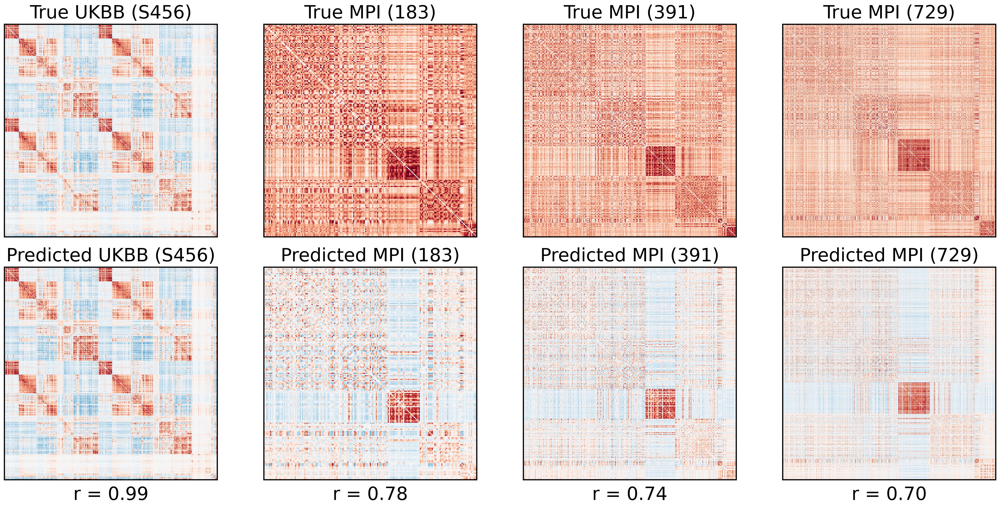

In [44]:
# Get predictions using model's predict function
predictions, targets = smt_cls_UKBB_model.predict(dataloader_UKBB)
predictions_ipa183, targets_ipa183 = smt_cls_UKBB_model.predict(dataloader_iPA183)
predictions_ipa391, targets_ipa391 = smt_cls_UKBB_model.predict(dataloader_iPA391)
predictions_ipa729, targets_ipa729 = smt_cls_UKBB_model.predict(dataloader_iPA729)

# Reconstruct connectomes
pred_connectome = reconstruct_connectome(predictions)
target_connectome = reconstruct_connectome(targets)
pred_connectome_183 = reconstruct_connectome(predictions_ipa183)
target_connectome_183 = reconstruct_connectome(targets_ipa183)
pred_connectome_391 = reconstruct_connectome(predictions_ipa391)
target_connectome_391 = reconstruct_connectome(targets_ipa391)
pred_connectome_729 = reconstruct_connectome(predictions_ipa729)
target_connectome_729 = reconstruct_connectome(targets_ipa729)

# Compute metrics
pearson_r = np.corrcoef(predictions.flatten(), targets.flatten())[0,1]
pearson_r_ipa183 = np.corrcoef(predictions_ipa183.flatten(), targets_ipa183.flatten())[0,1]
pearson_r_ipa391 = np.corrcoef(predictions_ipa391.flatten(), targets_ipa391.flatten())[0,1]
pearson_r_ipa729 = np.corrcoef(predictions_ipa729.flatten(), targets_ipa729.flatten())[0,1]

# Print metrics
print(f"UKBB Self-Prediction Results: Pearson r: {pearson_r:.2f}")
print(f"iPA183 Self-Prediction Results: Pearson r: {pearson_r_ipa183:.2f}")
print(f"iPA391 Self-Prediction Results: Pearson r: {pearson_r_ipa391:.2f}")
print(f"iPA729 Self-Prediction Results: Pearson r: {pearson_r_ipa729:.2f}")

# Set global font size
FONTSIZE = 26
plt.rcParams.update({'font.size': FONTSIZE})

plt.figure(figsize=(24, 12), dpi=300)

# True connectomes row
plt.subplot(241)
plt.imshow(target_connectome, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True UKBB (S456)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(242)
plt.imshow(target_connectome_183, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (183)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(243)
plt.imshow(target_connectome_391, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (391)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(244)
plt.imshow(target_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

# Predicted connectomes row
plt.subplot(245)
plt.imshow(pred_connectome, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted UKBB (S456)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(246)
plt.imshow(pred_connectome_183, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (183)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa183:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(247)
plt.imshow(pred_connectome_391, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (391)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa391:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(248)
plt.imshow(pred_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa729:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.tight_layout()
plt.show()


Source 183

UKBB Self-Prediction Results: Pearson r: 0.55
iPA183 Self-Prediction Results: Pearson r: 0.80
iPA391 Self-Prediction Results: Pearson r: 0.71
iPA729 Self-Prediction Results: Pearson r: 0.69


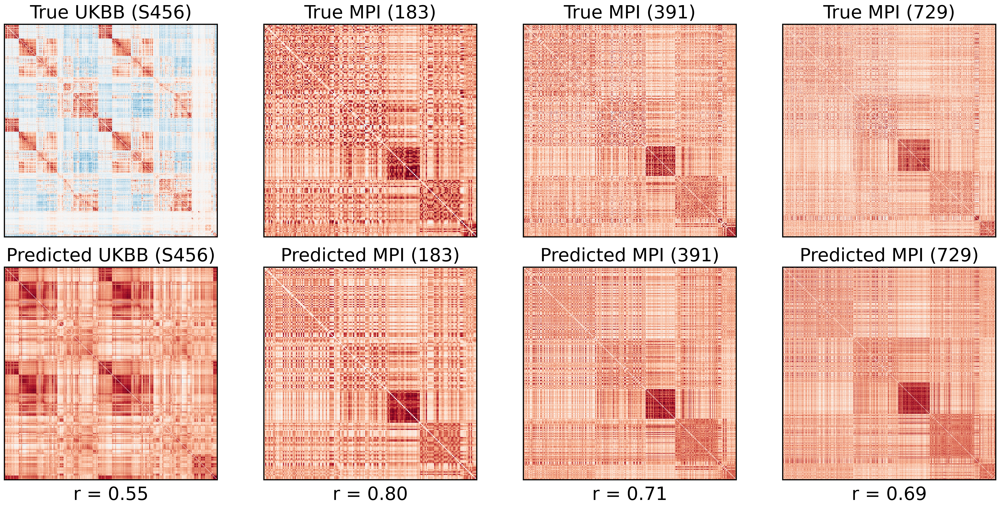

In [45]:
# Get predictions using model's predict function
predictions, targets = smt_cls_iPA183_model.predict(dataloader_UKBB)
predictions_ipa183, targets_ipa183 = smt_cls_iPA183_model.predict(dataloader_iPA183)
predictions_ipa391, targets_ipa391 = smt_cls_iPA183_model.predict(dataloader_iPA391)
predictions_ipa729, targets_ipa729 = smt_cls_iPA183_model.predict(dataloader_iPA729)

# Reconstruct connectomes
pred_connectome = reconstruct_connectome(predictions)
target_connectome = reconstruct_connectome(targets)
pred_connectome_183 = reconstruct_connectome(predictions_ipa183)
target_connectome_183 = reconstruct_connectome(targets_ipa183)
pred_connectome_391 = reconstruct_connectome(predictions_ipa391)
target_connectome_391 = reconstruct_connectome(targets_ipa391)
pred_connectome_729 = reconstruct_connectome(predictions_ipa729)
target_connectome_729 = reconstruct_connectome(targets_ipa729)

# Compute metrics
pearson_r = np.corrcoef(predictions.flatten(), targets.flatten())[0,1]
pearson_r_ipa183 = np.corrcoef(predictions_ipa183.flatten(), targets_ipa183.flatten())[0,1]
pearson_r_ipa391 = np.corrcoef(predictions_ipa391.flatten(), targets_ipa391.flatten())[0,1]
pearson_r_ipa729 = np.corrcoef(predictions_ipa729.flatten(), targets_ipa729.flatten())[0,1]

# Print metrics
print(f"UKBB Self-Prediction Results: Pearson r: {pearson_r:.2f}")
print(f"iPA183 Self-Prediction Results: Pearson r: {pearson_r_ipa183:.2f}")
print(f"iPA391 Self-Prediction Results: Pearson r: {pearson_r_ipa391:.2f}")
print(f"iPA729 Self-Prediction Results: Pearson r: {pearson_r_ipa729:.2f}")

# Set global font size
FONTSIZE = 26
plt.rcParams.update({'font.size': FONTSIZE})

plt.figure(figsize=(24, 12), dpi=300)

# True connectomes row
plt.subplot(241)
plt.imshow(target_connectome, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True UKBB (S456)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(242)
plt.imshow(target_connectome_183, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (183)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(243)
plt.imshow(target_connectome_391, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (391)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(244)
plt.imshow(target_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

# Predicted connectomes row
plt.subplot(245)
plt.imshow(pred_connectome, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted UKBB (S456)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(246)
plt.imshow(pred_connectome_183, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (183)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa183:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(247)
plt.imshow(pred_connectome_391, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (391)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa391:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(248)
plt.imshow(pred_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa729:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.tight_layout()
plt.show()


Source 391

UKBB Self-Prediction Results: Pearson r: 0.72
iPA183 Self-Prediction Results: Pearson r: 0.92
iPA391 Self-Prediction Results: Pearson r: 0.98
iPA729 Self-Prediction Results: Pearson r: 0.86


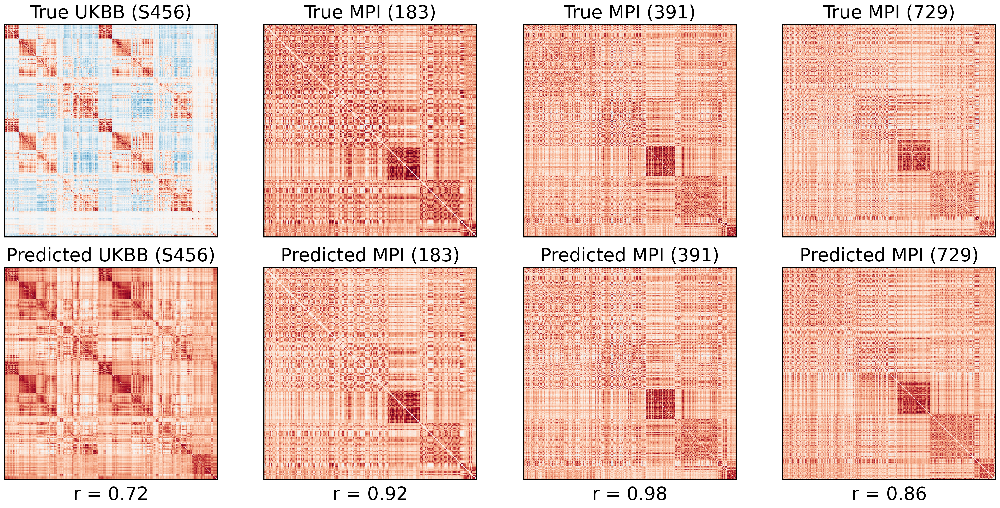

In [46]:
# Get predictions using model's predict function
predictions, targets = smt_cls_iPA391_model.predict(dataloader_UKBB)
predictions_ipa183, targets_ipa183 = smt_cls_iPA391_model.predict(dataloader_iPA183)
predictions_ipa391, targets_ipa391 = smt_cls_iPA391_model.predict(dataloader_iPA391)
predictions_ipa729, targets_ipa729 = smt_cls_iPA391_model.predict(dataloader_iPA729)

# Reconstruct connectomes
pred_connectome = reconstruct_connectome(predictions)
target_connectome = reconstruct_connectome(targets)
pred_connectome_183 = reconstruct_connectome(predictions_ipa183)
target_connectome_183 = reconstruct_connectome(targets_ipa183)
pred_connectome_391 = reconstruct_connectome(predictions_ipa391)
target_connectome_391 = reconstruct_connectome(targets_ipa391)
pred_connectome_729 = reconstruct_connectome(predictions_ipa729)
target_connectome_729 = reconstruct_connectome(targets_ipa729)

# Compute metrics
pearson_r = np.corrcoef(predictions.flatten(), targets.flatten())[0,1]
pearson_r_ipa183 = np.corrcoef(predictions_ipa183.flatten(), targets_ipa183.flatten())[0,1]
pearson_r_ipa391 = np.corrcoef(predictions_ipa391.flatten(), targets_ipa391.flatten())[0,1]
pearson_r_ipa729 = np.corrcoef(predictions_ipa729.flatten(), targets_ipa729.flatten())[0,1]

# Print metrics
print(f"UKBB Self-Prediction Results: Pearson r: {pearson_r:.2f}")
print(f"iPA183 Self-Prediction Results: Pearson r: {pearson_r_ipa183:.2f}")
print(f"iPA391 Self-Prediction Results: Pearson r: {pearson_r_ipa391:.2f}")
print(f"iPA729 Self-Prediction Results: Pearson r: {pearson_r_ipa729:.2f}")

# Set global font size
FONTSIZE = 26
plt.rcParams.update({'font.size': FONTSIZE})

plt.figure(figsize=(24, 12), dpi=300)

# True connectomes row
plt.subplot(241)
plt.imshow(target_connectome, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True UKBB (S456)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(242)
plt.imshow(target_connectome_183, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (183)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(243)
plt.imshow(target_connectome_391, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (391)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(244)
plt.imshow(target_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

# Predicted connectomes row
plt.subplot(245)
plt.imshow(pred_connectome, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted UKBB (S456)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(246)
plt.imshow(pred_connectome_183, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (183)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa183:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(247)
plt.imshow(pred_connectome_391, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (391)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa391:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(248)
plt.imshow(pred_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa729:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.tight_layout()
plt.show()

Source 729

UKBB Self-Prediction Results: Pearson r: 0.75
iPA183 Self-Prediction Results: Pearson r: 0.92
iPA391 Self-Prediction Results: Pearson r: 0.92
iPA729 Self-Prediction Results: Pearson r: 0.99


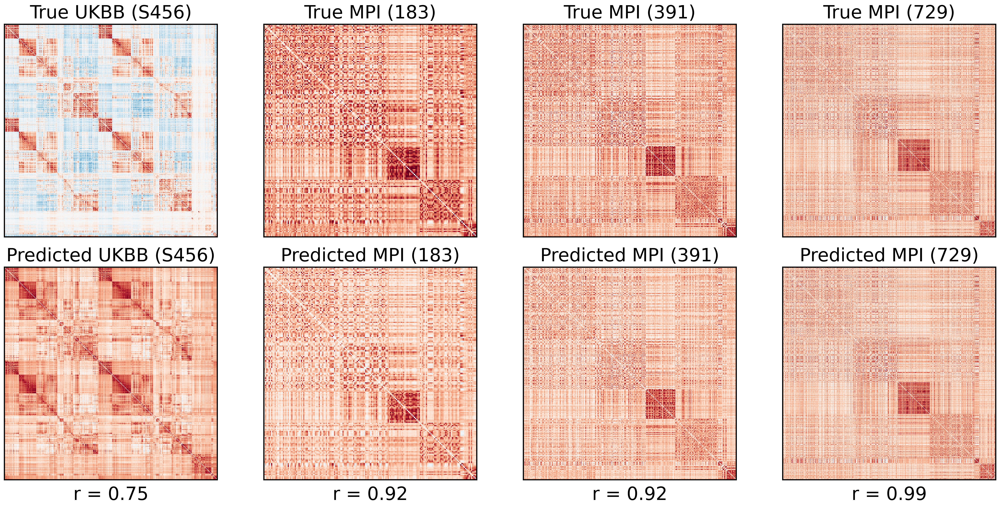

In [47]:
# Get predictions using model's predict function
predictions, targets = smt_cls_iPA729_model.predict(dataloader_UKBB)
predictions_ipa183, targets_ipa183 = smt_cls_iPA729_model.predict(dataloader_iPA183)
predictions_ipa391, targets_ipa391 = smt_cls_iPA729_model.predict(dataloader_iPA391)
predictions_ipa729, targets_ipa729 = smt_cls_iPA729_model.predict(dataloader_iPA729)

# Reconstruct connectomes
pred_connectome = reconstruct_connectome(predictions)
target_connectome = reconstruct_connectome(targets)
pred_connectome_183 = reconstruct_connectome(predictions_ipa183)
target_connectome_183 = reconstruct_connectome(targets_ipa183)
pred_connectome_391 = reconstruct_connectome(predictions_ipa391)
target_connectome_391 = reconstruct_connectome(targets_ipa391)
pred_connectome_729 = reconstruct_connectome(predictions_ipa729)
target_connectome_729 = reconstruct_connectome(targets_ipa729)

# Compute metrics
pearson_r = np.corrcoef(predictions.flatten(), targets.flatten())[0,1]
pearson_r_ipa183 = np.corrcoef(predictions_ipa183.flatten(), targets_ipa183.flatten())[0,1]
pearson_r_ipa391 = np.corrcoef(predictions_ipa391.flatten(), targets_ipa391.flatten())[0,1]
pearson_r_ipa729 = np.corrcoef(predictions_ipa729.flatten(), targets_ipa729.flatten())[0,1]

# Print metrics
print(f"UKBB Self-Prediction Results: Pearson r: {pearson_r:.2f}")
print(f"iPA183 Self-Prediction Results: Pearson r: {pearson_r_ipa183:.2f}")
print(f"iPA391 Self-Prediction Results: Pearson r: {pearson_r_ipa391:.2f}")
print(f"iPA729 Self-Prediction Results: Pearson r: {pearson_r_ipa729:.2f}")

# Set global font size
FONTSIZE = 26
plt.rcParams.update({'font.size': FONTSIZE})

plt.figure(figsize=(24, 12), dpi=300)

# True connectomes row
plt.subplot(241)
plt.imshow(target_connectome, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True UKBB (S456)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(242)
plt.imshow(target_connectome_183, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (183)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(243)
plt.imshow(target_connectome_391, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (391)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

plt.subplot(244)
plt.imshow(target_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('True MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xticks([])
plt.yticks([])

# Predicted connectomes row
plt.subplot(245)
plt.imshow(pred_connectome, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted UKBB (S456)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(246)
plt.imshow(pred_connectome_183, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (183)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa183:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(247)
plt.imshow(pred_connectome_391, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (391)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa391:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.subplot(248)
plt.imshow(pred_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa729:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])

plt.tight_layout()
plt.show()


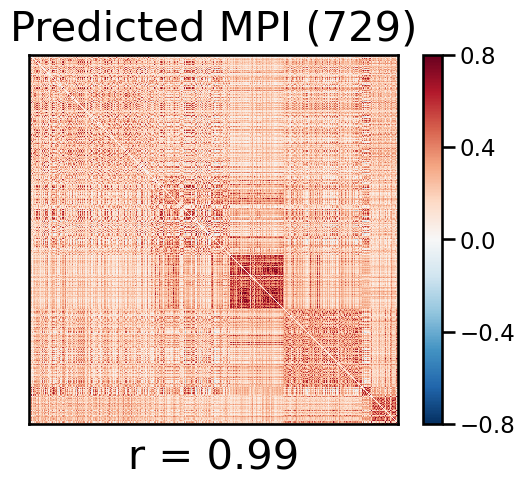

In [49]:
im = plt.imshow(pred_connectome_729, cmap='RdBu_r', vmin=-0.8, vmax=0.8, interpolation='nearest')
plt.title('Predicted MPI (729)', pad=10, fontsize=FONTSIZE+4)
plt.xlabel(f'r = {pearson_r_ipa729:.2f}', fontsize=FONTSIZE+4, labelpad=10)
plt.xticks([])
plt.yticks([])
cbar = plt.colorbar(im, ticks=[-0.8, -0.4, 0, 0.4, 0.8])